<a href="https://colab.research.google.com/github/MorningstarDeep/Plant-Species-Classfication/blob/main/Plant_Species_Identification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Step 1: Install Kaggle API
!pip install kaggle

# Step 2: Upload kaggle.json
from google.colab import files
files.upload()  # This will prompt you to upload the kaggle.json file

# Step 3: Setup Kaggle API credentials
import os
os.environ['KAGGLE_CONFIG_DIR'] = "/content/"

# Step 4: Download the dataset
!kaggle datasets download -d kacpergregorowicz/house-plant-species

# Step 5: Unzip the dataset
!unzip house-plant-species.zip -d /content/house_plant_species/

# Optional: Check the contents of the extracted folder
import os
print(os.listdir('/content/house_plant_species'))


Streaming output truncated to the last 5000 lines.
  inflating: /content/house_plant_species/house_plant_species/Parlor Palm (Chamaedorea elegans)/205.jpeg  
  inflating: /content/house_plant_species/house_plant_species/Parlor Palm (Chamaedorea elegans)/206.jpg  
  inflating: /content/house_plant_species/house_plant_species/Parlor Palm (Chamaedorea elegans)/207.jpg  
  inflating: /content/house_plant_species/house_plant_species/Parlor Palm (Chamaedorea elegans)/208.jpg  
  inflating: /content/house_plant_species/house_plant_species/Parlor Palm (Chamaedorea elegans)/209.jpg  
  inflating: /content/house_plant_species/house_plant_species/Parlor Palm (Chamaedorea elegans)/21.jpg  
  inflating: /content/house_plant_species/house_plant_species/Parlor Palm (Chamaedorea elegans)/210.jpg  
  inflating: /content/house_plant_species/house_plant_species/Parlor Palm (Chamaedorea elegans)/211.png  
  inflating: /content/house_plant_species/house_plant_species/Parlor Palm (Chamaedorea elegans)/212.j

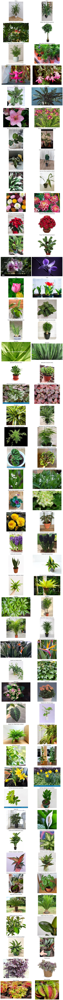

In [ ]:
import os
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import warnings
warnings.filterwarnings("ignore")
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model


dataset_path = '/content/house_plant_species/house_plant_species'

classes = os.listdir(dataset_path)

num_images_per_class = 2
num_classes = len(classes)

plt.figure(figsize=(12, num_classes * 4))

for i, class_name in enumerate(classes):
    class_folder = os.path.join(dataset_path, class_name)
    images = os.listdir(class_folder)


    for j in range(min(num_images_per_class, len(images))):
        img_path = os.path.join(class_folder, images[j])
        img = Image.open(img_path)

        plt.subplot(num_classes, num_images_per_class, i * num_images_per_class + j + 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title(class_name)

plt.tight_layout()
plt.show()


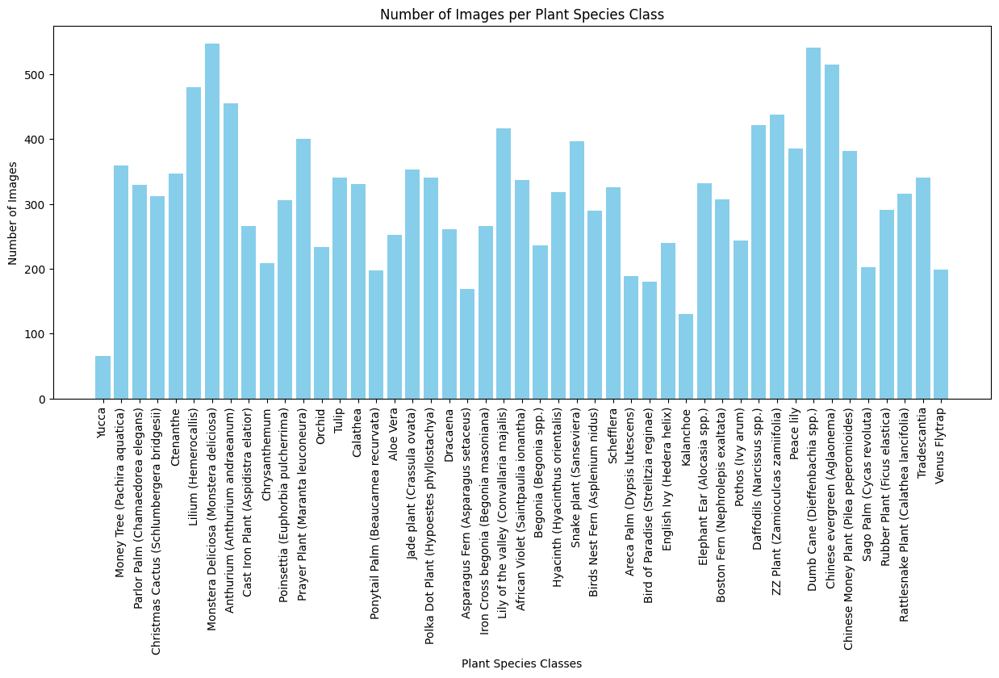

In [ ]:
image_counts = []


for class_name in classes:
    class_folder = os.path.join(dataset_path, class_name)
    images = os.listdir(class_folder)
    image_counts.append(len(images))

plt.figure(figsize=(15, 6))
plt.bar(classes, image_counts, color='skyblue')
plt.xticks(rotation=90)  # Rotate class names for better visibility
plt.xlabel('Plant Species Classes')
plt.ylabel('Number of Images')
plt.title('Number of Images per Plant Species Class')
plt.show()


Found 11715 images belonging to 47 classes.
Found 2905 images belonging to 47 classes.
16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/5
367/367 ━━━━━━━━━━━━━━━━━━━━ 577s 1s/step - accuracy: 0.5631 - loss: 1.7246 - val_accuracy: 0.0444 - val_loss: 4.2811
Epoch 2/5
367/367 ━━━━━━━━━━━━━━━━━━━━ 400s 1s/step - accuracy: 0.8539 - loss: 0.4803 - val_accuracy: 0.6114 - val_loss: 1.4314
Epoch 3/5
367/367 ━━━━━━━━━━━━━━━━━━━━ 368s 989ms/step - accuracy: 0.9044 - loss: 0.3058 - val_accuracy: 0.7955 - val_loss: 0.7643
Epoch 4/5
367/367 ━━━━━━━━━━━━━━━━━━━━ 383s 993ms/step - accuracy: 0.9269 - loss: 0.2403 - val_accuracy: 0.8496 - val_loss: 0.5869
Epoch 5/5
367/367 ━━━━━━━━━━━━━━━━━━━━ 390s 1s/step - accuracy: 0.9343 - loss: 0.2001 - val_accuracy: 0.7924 - val_loss: 0.8450


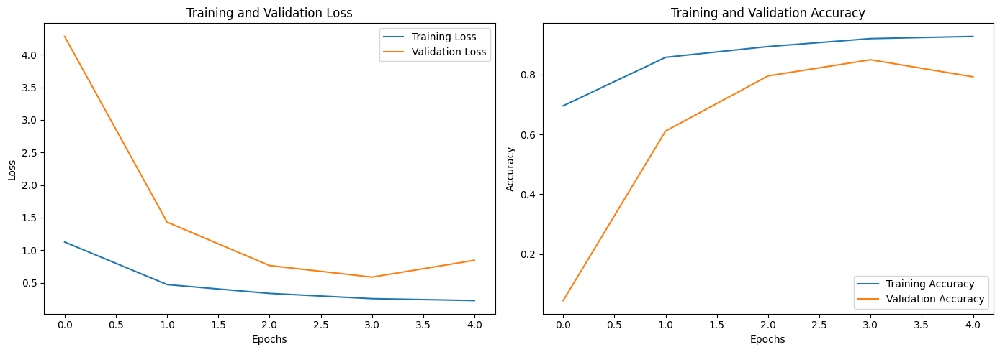

In [ ]:
img_height, img_width = 224, 224
batch_size = 32


train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

train_generator = train_datagen.flow_from_directory(
    dataset_path,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    dataset_path,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

#  pretrained EfficientNetB0 model
base_model = EfficientNetB0(weights='imagenet', include_top=False)


x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu')(x)
predictions = Dense(len(train_generator.class_indices), activation='softmax')(x)


model = Model(inputs=base_model.input, outputs=predictions)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
history = model.fit(train_generator, validation_data=validation_generator, epochs=5)


plt.figure(figsize=(14, 5))

plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plotting training and validation accuracy
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()



In [ ]:
# Save the trained model as an .h5 file
model.save('houseplant_species_model.h5')


In [ ]:
from google.colab import files

# Download the saved model to your local machine
files.download('houseplant_species_model.h5')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Please upload an image for prediction:


Saving 61BGrpx9SmL._AC_UF1000,1000_QL80_.jpg to 61BGrpx9SmL._AC_UF1000,1000_QL80_ (1).jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


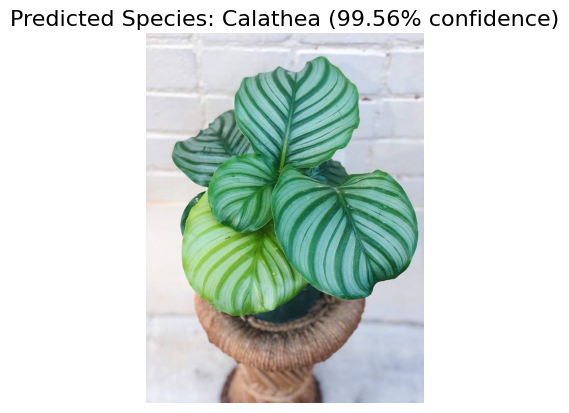

In [ ]:
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model
from google.colab import files
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Load the trained model
model = load_model('houseplant_species_model.h5')

# Path to the folder where your training images are stored
train_data_dir = '/content/house_plant_species/house_plant_species/'

# Automatically extract class labels from folder names
class_labels = sorted(os.listdir(train_data_dir))  # Folder names should represent species names

# Ask the user to upload a file
print("Please upload an image for prediction:")
uploaded = files.upload()

# Load and preprocess the uploaded image
for file_name in uploaded.keys():
    img_path = file_name

    # Load the uploaded image
    img = Image.open(img_path)

    # Preprocess the image (resize and normalize)
    img_resized = img.resize((224, 224))  # Resize to match model input size
    img_array = image.img_to_array(img_resized)
    img_array = np.expand_dims(img_array, axis=0)
    img_array /= 255.0  # Normalize the image (if you did so during training)

    # Get the model's prediction (probabilities for each class)
    predictions = model.predict(img_array)

    # Get the predicted class index
    predicted_class = np.argmax(predictions, axis=1)

    # Get the predicted species name and accuracy (confidence score)
    predicted_species = class_labels[predicted_class[0]]
    confidence = predictions[0][predicted_class[0]] * 100  # Convert to percentage

    # Display the uploaded image with the predicted species name and confidence score
    plt.imshow(img)
    plt.axis('off')
    plt.title(f'Predicted Species: {predicted_species} ({confidence:.2f}% confidence)', fontsize=16)
    plt.show()
